In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from imblearn.over_sampling import SMOTE
from imblearn.pipeline import Pipeline
from scipy.stats import chi2_contingency
from sklearn.decomposition import PCA
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import mutual_info_classif
from sklearn.metrics import classification_report

In [3]:
# Đọc dữ liệu
df = pd.read_csv('./Training Data.csv')

In [4]:
fig = px.bar(x = df['Risk_Flag'].value_counts(), color = ['No', 'Yes'], title = 'Biểu đồ cột thể hiện số lượng khách hàng theo Risk Flag',
            labels = {'x': 'Risk Groups'})
fig.show()

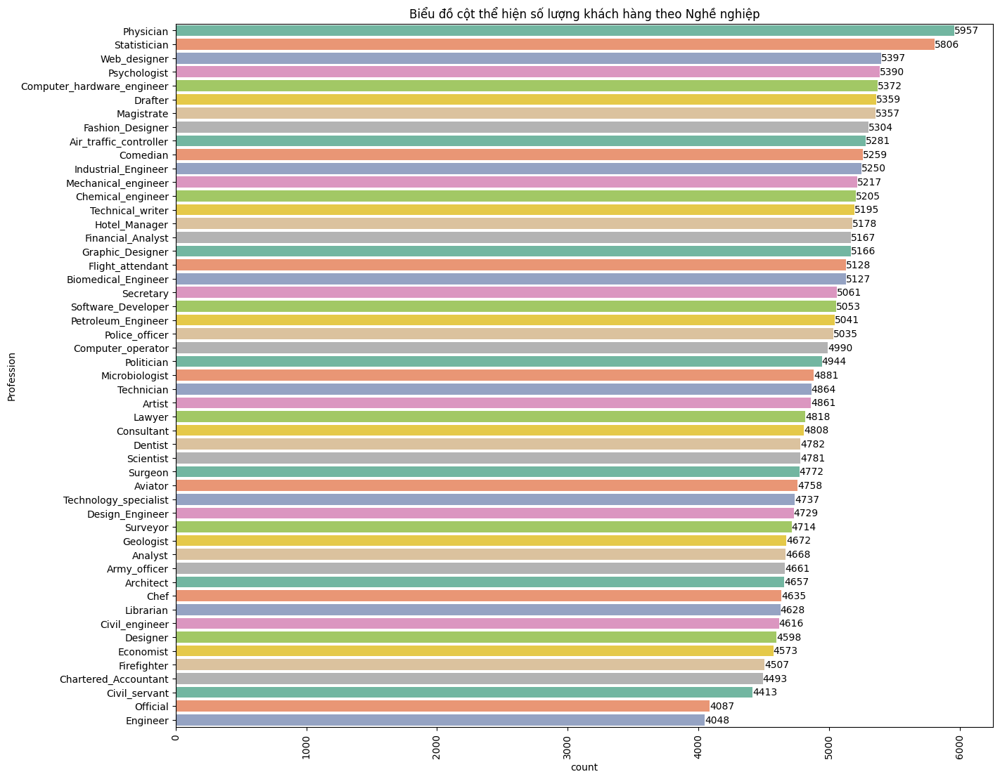

In [5]:
plt.figure(figsize=(15,13))
ax = sns.countplot(data = df , y=df["Profession"].sort_values(), order = df['Profession'].value_counts().index, palette="Set2")
plt.xticks(rotation=90)
plt.title('Biểu đồ cột thể hiện số lượng khách hàng theo Nghề nghiệp')
for bars in ax.containers:
        ax.bar_label(bars)

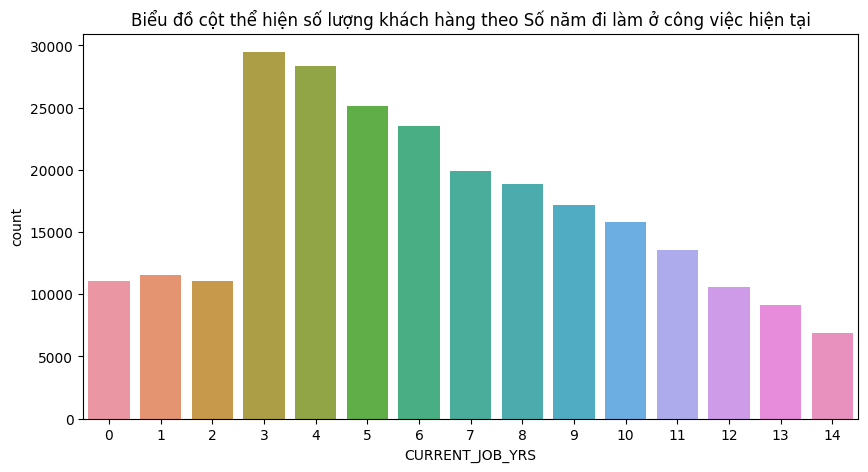

In [6]:
plt.figure(figsize=(10,5))
sns.countplot(x="CURRENT_JOB_YRS", data=df)
plt.title('Biểu đồ cột thể hiện số lượng khách hàng theo Số năm đi làm ở công việc hiện tại')
plt.show()

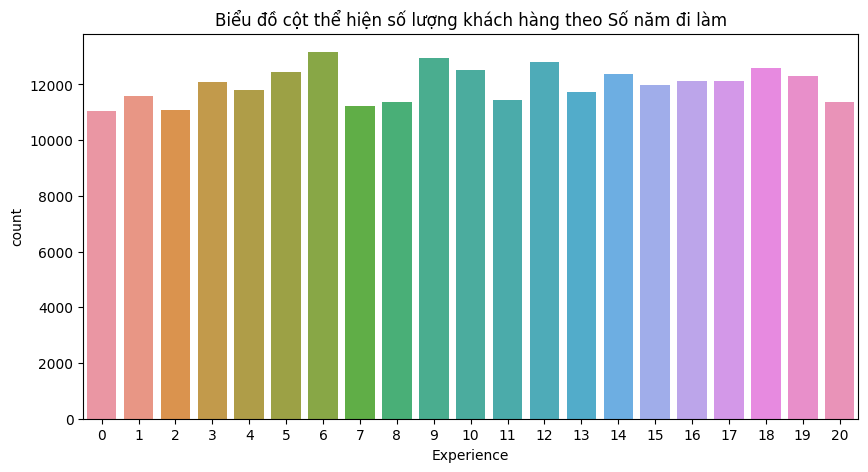

In [7]:
plt.figure(figsize=(10,5))
sns.countplot(x="Experience", data=df)
plt.title('Biểu đồ cột thể hiện số lượng khách hàng theo Số năm đi làm')
plt.show()

In [8]:
fig = px.box(data_frame = df, y = 'Income', title = 'Biểu đồ hộp thể hiện thông tin Thu nhập')
fig.show()

In [9]:
fig = px.box(data_frame = df, y = 'Age', title = 'Biểu đồ hộp thể hiện thông tin Độ tuổi')
fig.show()

In [10]:
df["House_Ownership"].replace({"rented": "Rented", "owned": "Owned", "norent_noown": "Neither Rent nor Own"}, inplace=True)
fig = go.Figure(data = [go.Pie(labels = df['House_Ownership'], pull=[0.05, 0])])
fig.update_traces(hoverinfo = 'label+percent', textinfo = 'label+value', textfont_size = 15, hole = 0.4,
                  marker = dict(line = dict(color = '#000000', width = 2)))
fig.update_layout( title_text = "Biểu đồ tròn thể hiện số lượng khách hàng theo Sở hữu nhà")
fig.show()

In [11]:
df["Car_Ownership"].replace({"no": "No", "yes": "Yes"}, inplace=True)
fig = go.Figure(data = [go.Pie(labels = df['Car_Ownership'])])
fig.update_traces(hoverinfo = 'label+percent', textinfo = 'label+value', textfont_size=15, hole = 0.4,
                  marker=dict(line = dict(color = '#000000', width = 2)))
fig.update_layout( title_text="Biểu đồ tròn thể hiện số lượng khách hàng theo Sở xe hơi")
fig.show()

In [12]:
df["Married/Single"].replace({"single": "Single", "married": "Married"}, inplace=True)
fig = go.Figure(data = [go.Pie(labels = df['Married/Single'])])
fig.update_traces(hoverinfo = 'label+percent', textinfo = 'label+value', textfont_size=15, hole = 0.4,
                  marker=dict(line = dict(color = '#000000', width = 2)))
fig.update_layout( title_text="Biểu đồ tròn thể hiện số lượng khách hàng theo Tình trạng hôn nhân")
fig.show()

In [13]:
fig = go.Figure(data = [go.Pie(labels = df['STATE'])])
fig.update_traces(textposition='inside', hoverinfo = 'label+percent', textinfo = 'label+value', textfont_size = 15, hole = 0.4,
                  marker = dict(line = dict(color = '#000000', width = 2)))
fig.update_layout(title_text = "Biểu đồ tròn thể hiện số lượng khách hàng theo Bang cư trú", 
                  annotations=[dict(text='States', x=0.5, y=0.5, font_size=15, showarrow=False)])
fig.show()

In [14]:
# Thay đổi tên thuộc tính
df.columns = df.columns.str.lower()
df.rename(columns={"married/single": "married_single"}, inplace=True)

# Loại bỏ thuộc tính city
df = df.drop('city', axis = 1)

# Chuyển kiểu dữ liệu của thuộc tính risk_flag từ 1, 0 thành 'Yes', 'No'
df["risk_flag"] = df["risk_flag"].map({0: 'No', 1: 'Yes'})


In [15]:
# Sắp xếp lại các hàng theo thứ tự ngẫu nhiên
df = df.sample(frac=1)

risk_data = df.loc[df["risk_flag"] == 'Yes']
not_risk_data = df.loc[df["risk_flag"] == 'No'][:30996]

normal_distributed_data = pd.concat([risk_data, not_risk_data])

loan = normal_distributed_data.sample(frac=1, random_state=42)

In [16]:
# Lưu dữ liệu
loan.to_csv('data.csv',index=False)